In [1]:
library("Seurat")

Attaching SeuratObject



In [2]:
library("SeuratData")

── Installed datasets ───────────────────────────────────── SeuratData v0.2.2 ──

✔ ssHippo  3.1.4                        ✔ stxBrain 0.1.1


────────────────────────────────────── Key ─────────────────────────────────────

✔ Dataset loaded successfully
❯ Dataset built with a newer version of Seurat than installed
❓ Unknown version of Seurat installed




In [ ]:
InstallData("ssHippo")

In [ ]:
citation(

In [3]:
?ssHippo

ssHippo {ssHippo.SeuratData},R Documentation


In [3]:
library("ggplot2")

In [4]:
library("dplyr")


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




In [5]:
library("patchwork")

In [6]:
?stxBrain

stxBrain {stxBrain.SeuratData},R Documentation


In [20]:
brain1<-readRDS("brain1.rds")

In [21]:
brain2<-readRDS("brain2.rds")

In [31]:
brain1 <- LoadData("stxBrain", type = "posterior1")

In [7]:
brain2 <- LoadData("stxBrain", type = "posterior2")

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


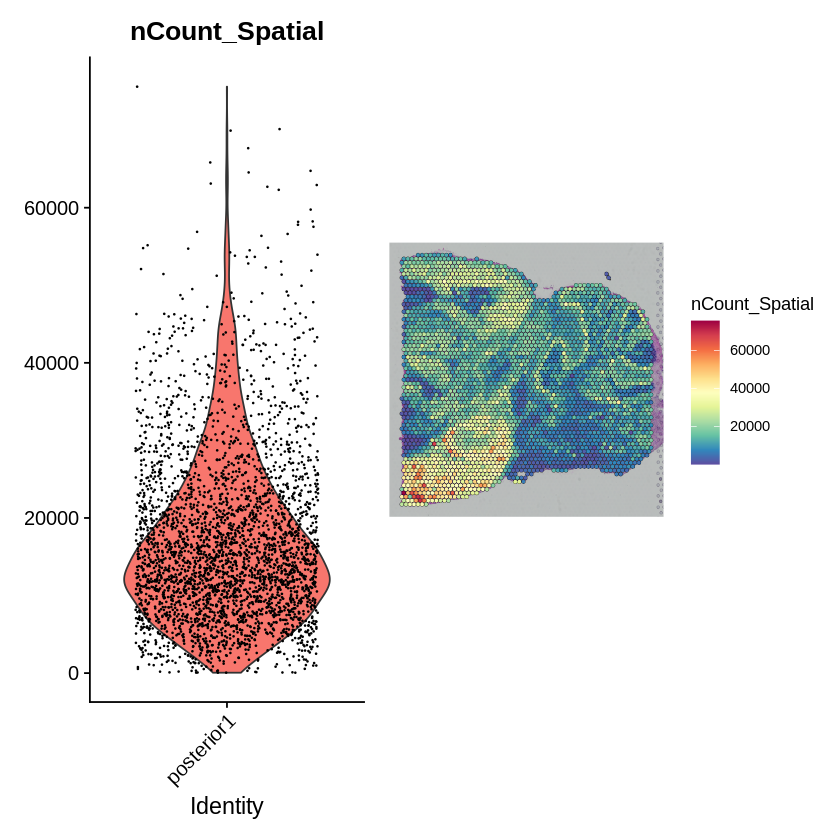

In [8]:
plot1 <- VlnPlot(brain1, features = "nCount_Spatial", pt.size = 0.1) + NoLegend()
plot2 <- SpatialFeaturePlot(brain1, features = "nCount_Spatial") + theme(legend.position = "right")
wrap_plots(plot1, plot2)

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


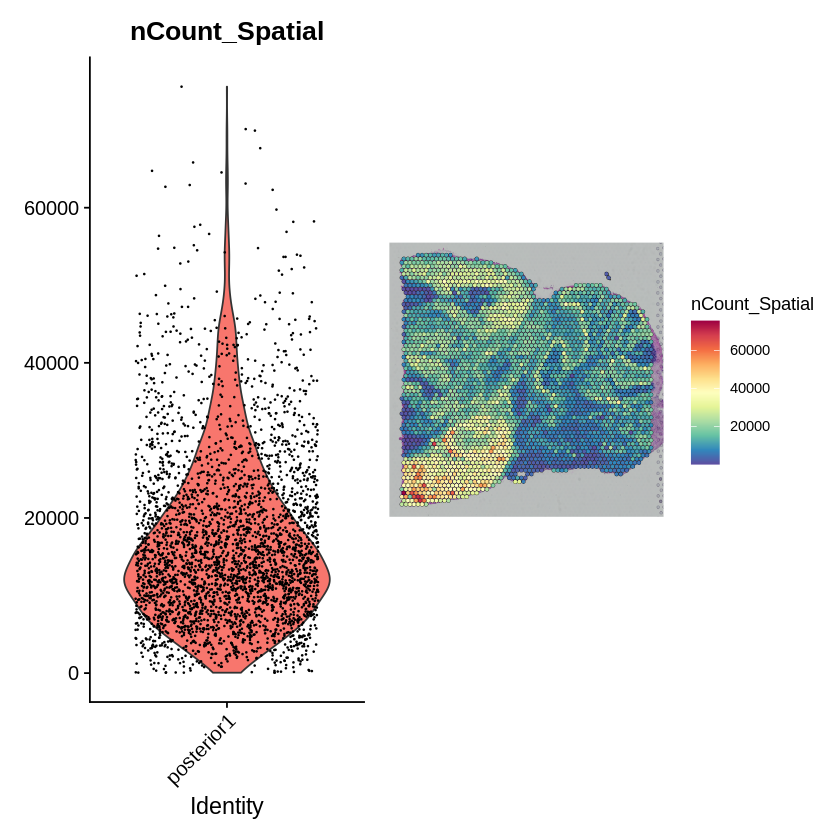

In [9]:
plot3 <- VlnPlot(brain2, features = "nCount_Spatial", pt.size = 0.1) + NoLegend()
plot4 <- SpatialFeaturePlot(brain2, features = "nCount_Spatial") + theme(legend.position = "right")
wrap_plots(plot1, plot2)

In [10]:
brain1 <- SCTransform(brain1, assay = "Spatial", verbose = FALSE)

In [32]:
brain1 <- NormalizeData(brain1, normalization.method = "LogNormalize", scale.factor = 10000)

In [33]:
brain1 <- FindVariableFeatures(brain1, selection.method = "vst", nfeatures = 3000)

In [34]:
all.genes <- rownames(brain1)
brain1 <- ScaleData(brain1, features = all.genes)

Centering and scaling data matrix



In [30]:
saveRDS(brain1,"SCTpostbrain1.rds")

In [11]:
brain2 <- SCTransform(brain2, assay = "Spatial", verbose = FALSE)

In [46]:
brain1 <- RunPCA(brain1, assay = "Spatial", verbose = FALSE)
brain1 <- FindNeighbors(brain1, reduction = "pca", dims = 1:50)
brain1 <- FindClusters(brain1, verbose = FALSE,resolution=1.0)
brain1 <- RunUMAP(brain1, reduction = "pca", dims = 1:50)

Computing nearest neighbor graph

Computing SNN

16:53:54 UMAP embedding parameters a = 0.9922 b = 1.112

16:53:54 Read 3353 rows and found 50 numeric columns

16:53:54 Using Annoy for neighbor search, n_neighbors = 30

16:53:54 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:53:54 Writing NN index file to temp file /tmp/RtmpwI906I/file5311ca5cd19e

16:53:54 Searching Annoy index using 1 thread, search_k = 3000

16:53:55 Annoy recall = 100%

16:53:55 Commencing smooth kNN distance calibration using 1 thread

16:53:56 Initializing from normalized Laplacian + noise

16:53:56 Commencing optimization for 500 epochs, with 141218 positive edges

16:54:06 Optimization finished



In [28]:
brain2 <- RunPCA(brain2, assay = "SCT", verbose = FALSE)
brain2 <- FindNeighbors(brain2, reduction = "pca", dims = 1:50)
brain2 <- FindClusters(brain2, verbose = FALSE)
brain2 <- RunUMAP(brain2, reduction = "pca", dims = 1:50)

Computing nearest neighbor graph

Computing SNN

16:42:38 UMAP embedding parameters a = 0.9922 b = 1.112

16:42:38 Read 3293 rows and found 50 numeric columns

16:42:38 Using Annoy for neighbor search, n_neighbors = 30

16:42:38 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:42:39 Writing NN index file to temp file /tmp/RtmpwI906I/file5311c3b7c4427

16:42:39 Searching Annoy index using 1 thread, search_k = 3000

16:42:39 Annoy recall = 100%

16:42:40 Commencing smooth kNN distance calibration using 1 thread

16:42:40 Initializing from normalized Laplacian + noise

16:42:40 Commencing optimization for 500 epochs, with 131196 positive edges

16:42:50 Optimization finished



Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



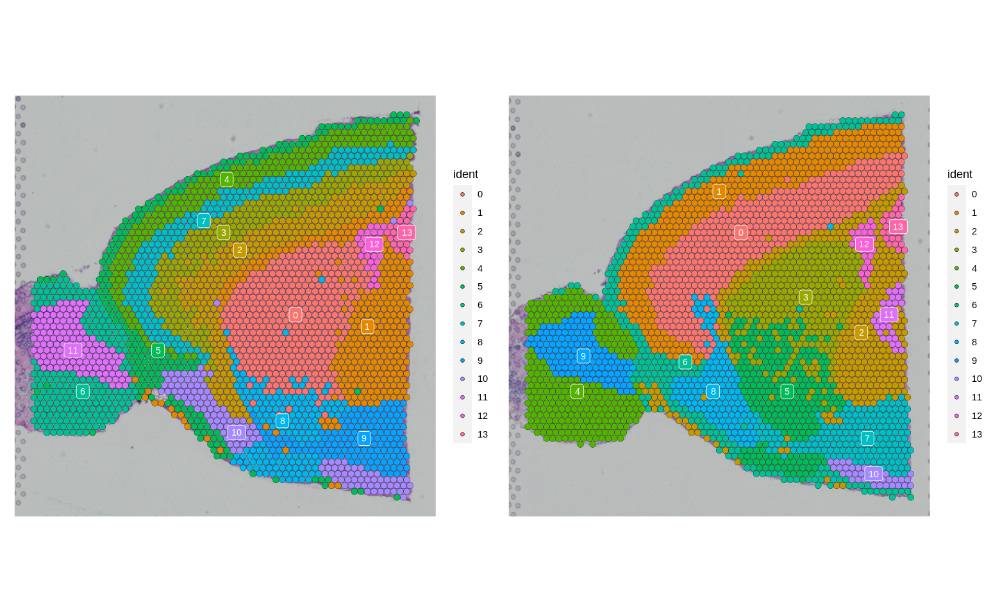

In [22]:
options(repr.plot.width=13, repr.plot.height=8)
p1 <- SpatialDimPlot(brain1, label = TRUE, label.size = 3)
p2 <- SpatialDimPlot(brain2, label = TRUE, label.size = 3)
p1+p2

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



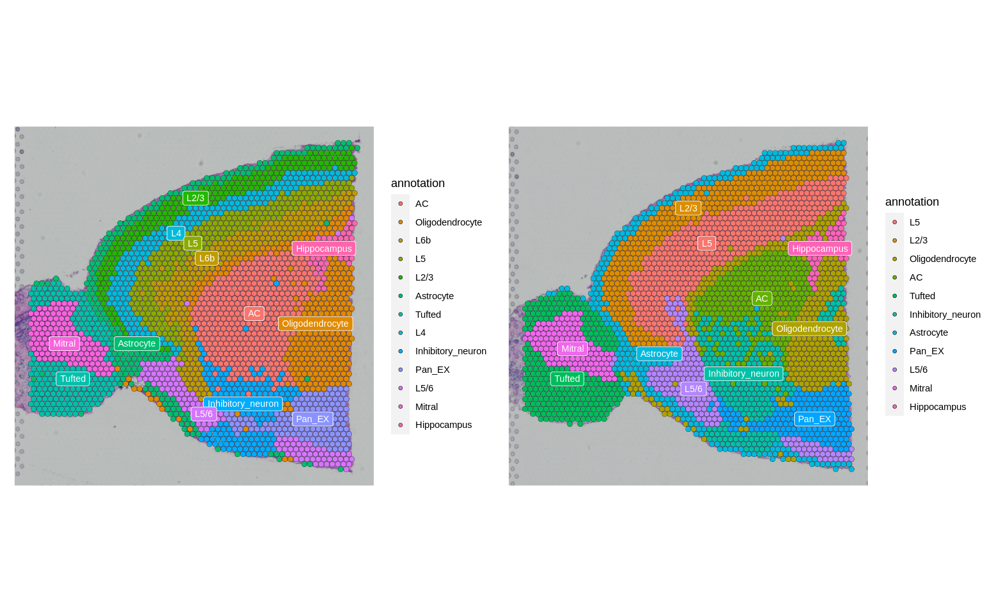

In [23]:
options(repr.plot.width=13, repr.plot.height=8)
p1 <- SpatialDimPlot(brain1, label = TRUE, label.size = 3,group.by = "annotation")
p2 <- SpatialDimPlot(brain2, label = TRUE, label.size = 3,group.by = "annotation")
p1+p2

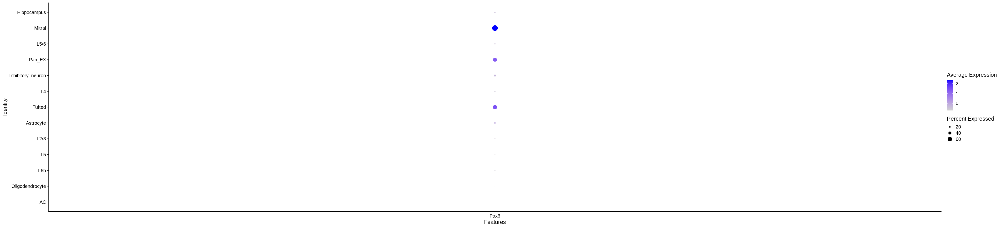

In [38]:
options(repr.plot.width=35, repr.plot.height=8)
DotPlot(brain1,feature = "Pax6",group.by="annotation")

In [11]:
options(repr.plot.width=35, repr.plot.height=8)
DotPlot(brain2,feature = "NeuN")

ERROR: Error in FetchData(object = object, vars = features, cells = cells): None of the requested variables were found: NeuN


Warning message in FetchData(object = object, vars = features, cells = cells):
“The following requested variables were not found: Baiap211, prox1, Scf1r, ptdgs, Gad67”


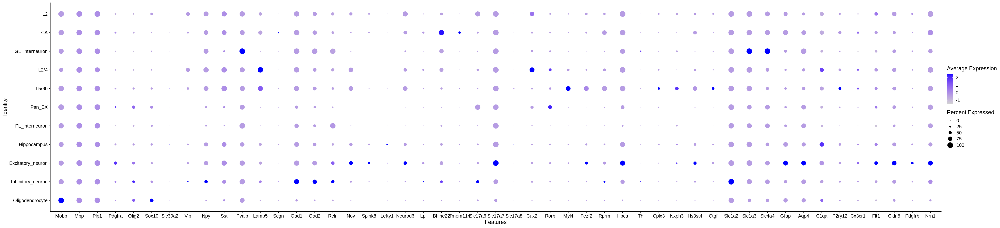

In [13]:
options(repr.plot.width=35, repr.plot.height=8)
DotPlot(brain2,feature = GENE,group.by = "annotation")

In [15]:
brain1$annotation<-brain1$seurat_clusters

In [17]:
current.cluster.ids <- c(0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16)
new.cluster.ids <- c("Oligodendrocyte","Inhibitory_neuron","Inhibitory_neuron","Inhibitory_neuron","Excitatory_neuron","Inhibitory_neuron","GL_Interneuron","Pan_EX","Astrocyte","Hippocampus","L2/3","L5/6","PL_Interneuron","L6b","CA","Oligodendrocyte","Oligodendrocyte")
brain1$annotation<-plyr::mapvalues(x=brain1$annotation,from =current.cluster.ids, to = new.cluster.ids)

Scale for 'fill' is already present. Adding another scale for 'fill', which
will replace the existing scale.



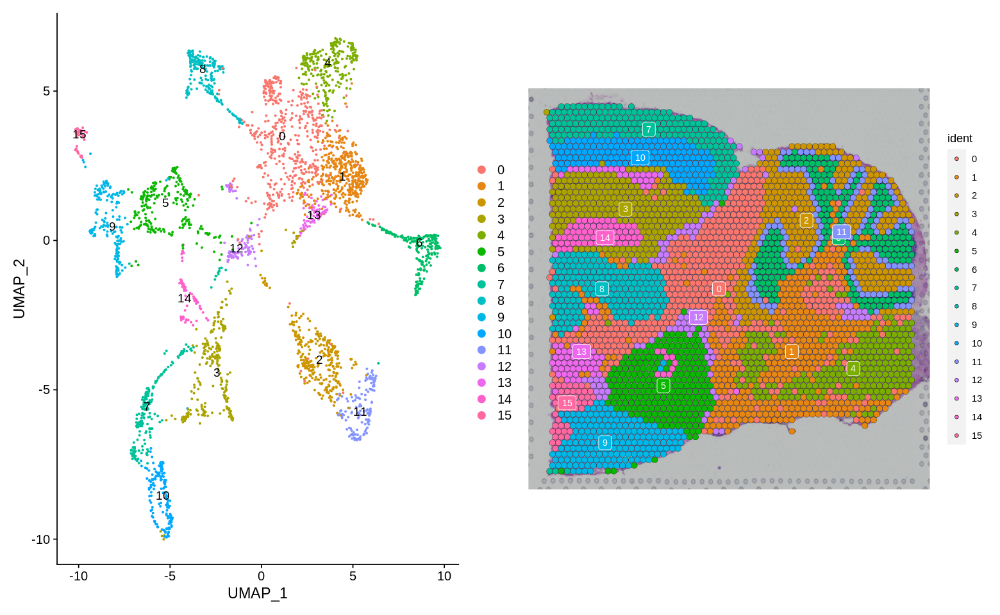

In [11]:
options(repr.plot.width=13, repr.plot.height=8)
p1 <- DimPlot(brain2, reduction = "umap", label = TRUE)
p2 <- SpatialDimPlot(brain2, label = TRUE, label.size = 3)
p1 + p2

In [12]:
brain1

An object of class Seurat 
48721 features across 3353 samples within 2 assays 
Active assay: SCT (17668 features, 3000 variable features)
 1 other assay present: Spatial
 2 dimensional reductions calculated: pca, umap

In [13]:
brain2

An object of class Seurat 
48567 features across 3293 samples within 2 assays 
Active assay: SCT (17514 features, 3000 variable features)
 1 other assay present: Spatial
 2 dimensional reductions calculated: pca, umap

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


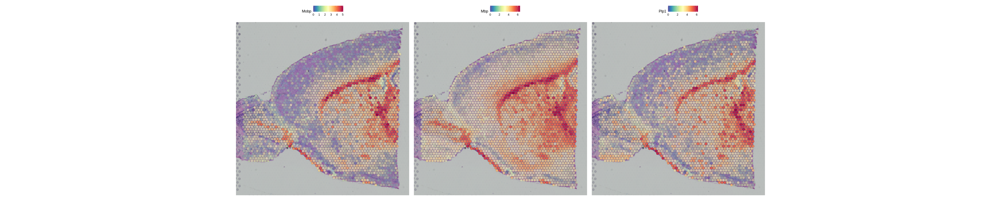

In [44]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Mobp",	"Mbp",	"Plp1"), alpha = c(0.1, 1))

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


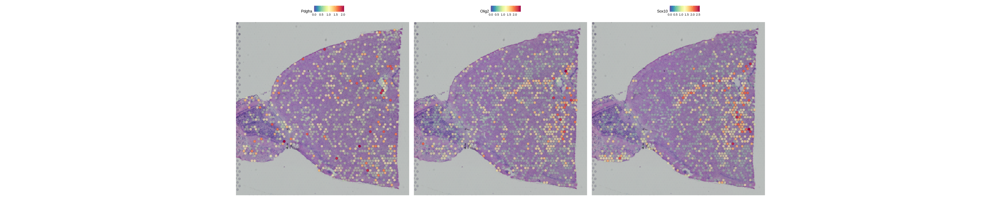

In [45]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Pdgfra",	"Olig2",	"Sox10"), alpha = c(0.1, 1))

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = F

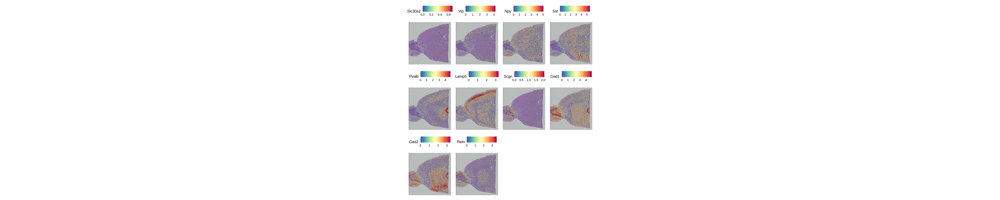

In [47]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Slc30a2",	"Vip",	"Npy",	"Sst",	"Pvalb",	"Lamp5",	"Scgn",	"Gad1",	"Gad2",	"Reln"), alpha = c(0.1, 1))

Warning message in FetchData(object = object, vars = features, slot = slot):
“The following requested variables were not found: Baiap211”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


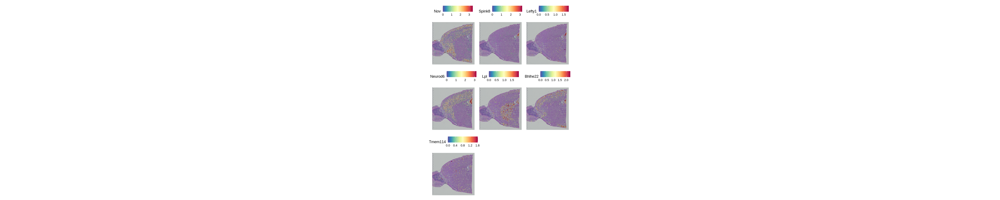

In [48]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Nov",	"Baiap211",	"Spink8",	"Lefty1",	"Neurod6",	"Lpl",	"Bhlhe22",	"Tmem114"), alpha = c(0.1, 1))

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


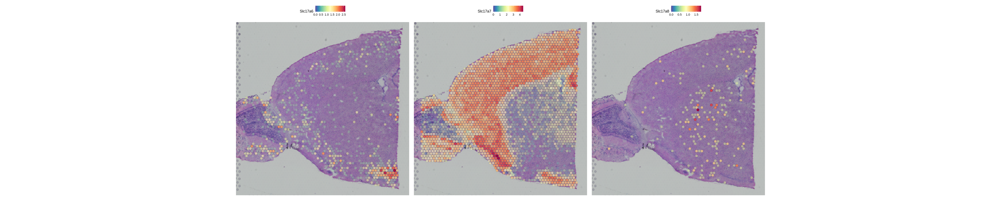

In [50]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Slc17a6",	"Slc17a7",	"Slc17a8"), alpha = c(0.1, 1))

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


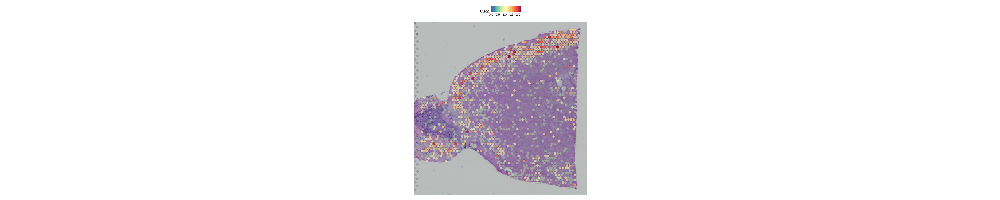

In [54]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Cux2"), alpha = c(0.1, 1))

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


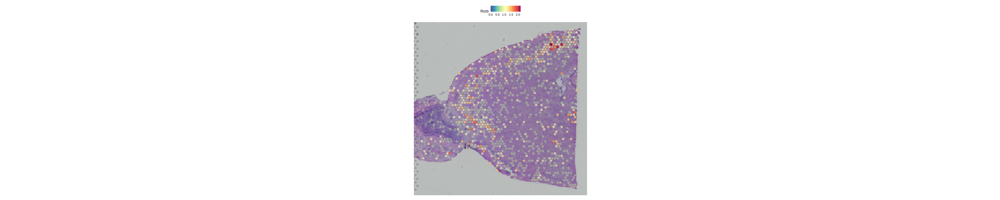

In [55]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Rorb"), alpha = c(0.1, 1))

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


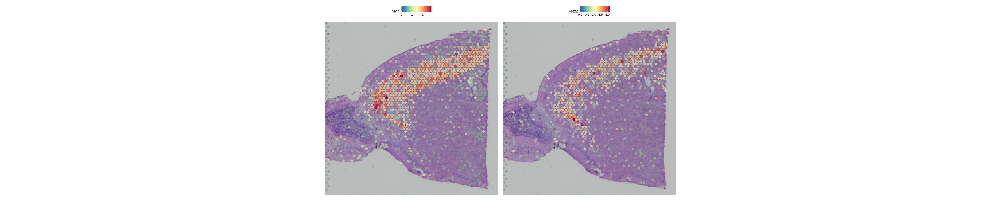

In [56]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Myl4","Fezf2"), alpha = c(0.1, 1))

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


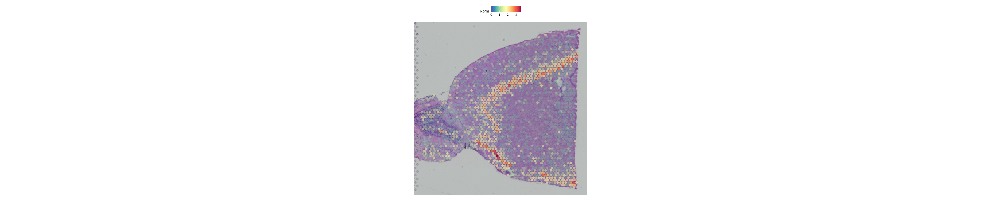

In [57]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Rprm"), alpha = c(0.1, 1))

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


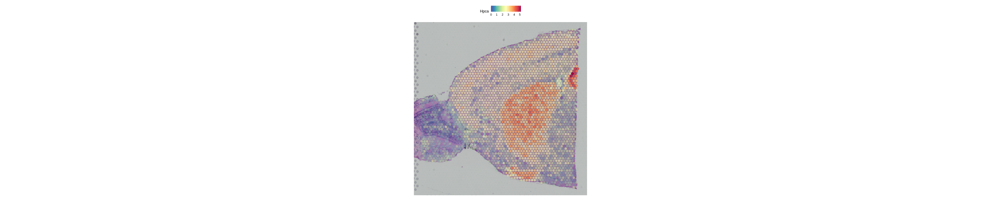

In [58]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Hpca"), alpha = c(0.1, 1))

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


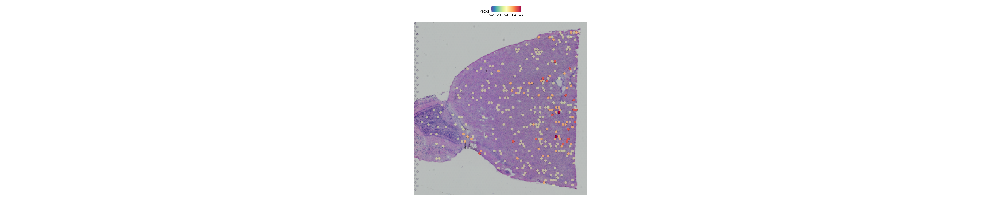

In [59]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Prox1"), alpha = c(0.1, 1))

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


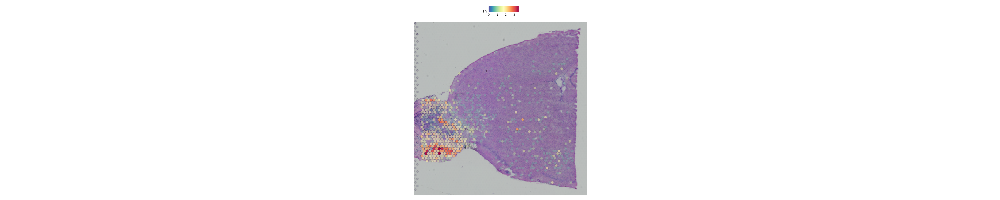

In [60]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Th"), alpha = c(0.1, 1))

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


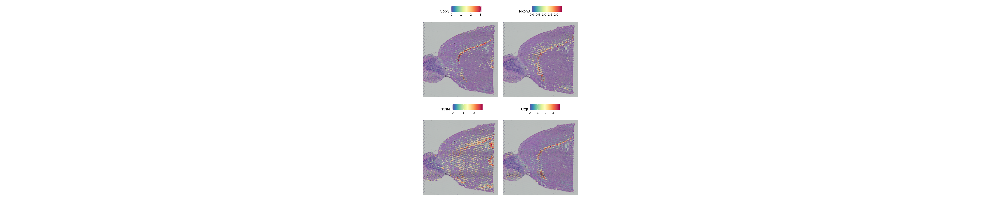

In [61]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Cplx3",	"Nxph3",	"Hs3st4",	"Ctgf"), alpha = c(0.1, 1))

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


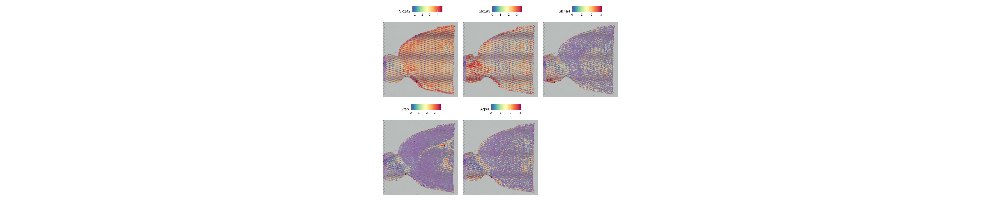

In [62]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Slc1a2",	"Slc1a3",	"Slc4a4",	"Gfap",	"Aqp4"), alpha = c(0.1, 1))

Warning message in FetchData(object = object, vars = features, slot = slot):
“The following requested variables were not found: Scf1r”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


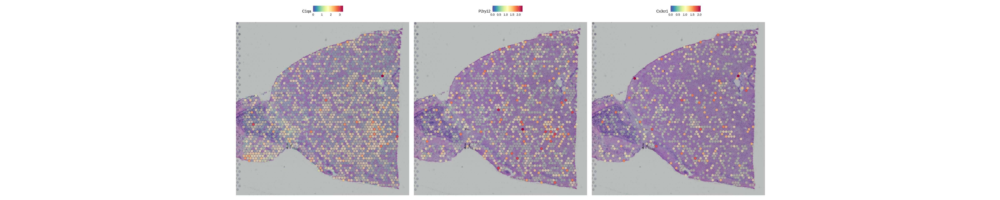

In [63]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("C1qa",	"Scf1r",	"P2ry12",	"Cx3cr1"), alpha = c(0.1, 1))

In [65]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("ptdgs"), alpha = c(0.1, 1))

ERROR: Error in FetchData(object = object, vars = features, slot = slot): None of the requested variables were found: ptdgs


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


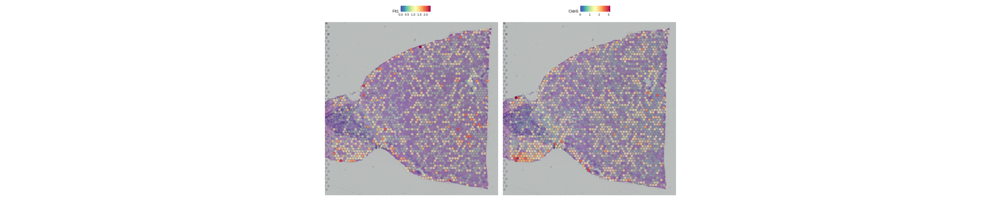

In [66]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Flt1","Cldn5"), alpha = c(0.1, 1))

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


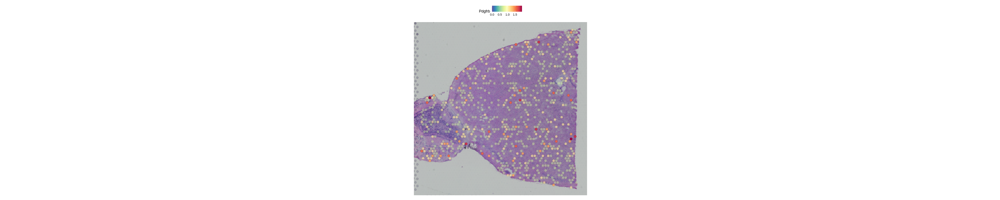

In [68]:
options(repr.plot.width=40, repr.plot.height=8)
SpatialFeaturePlot(brain1, features =c("Pdgfrb"), alpha = c(0.1, 1))

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


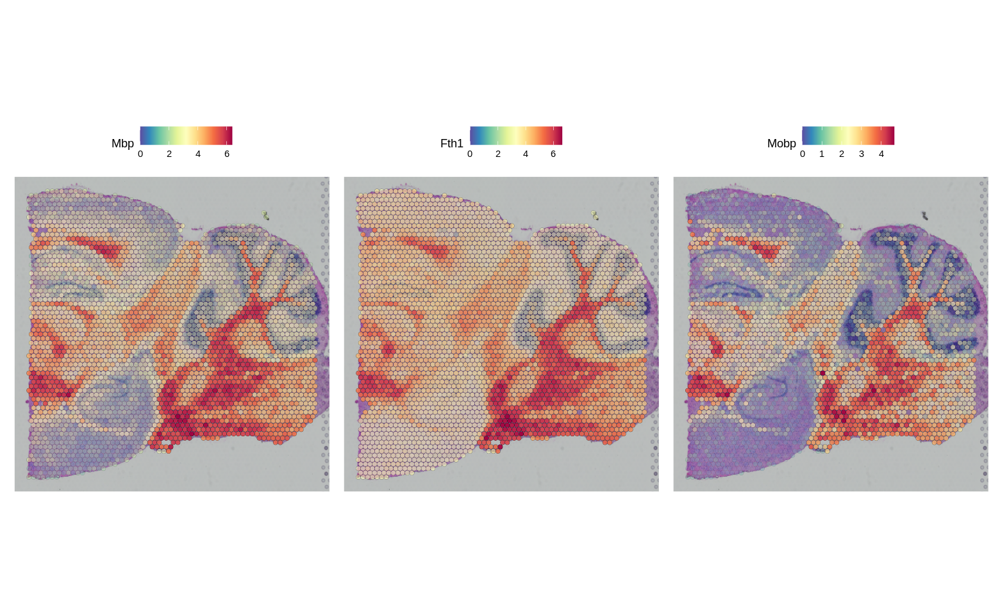

In [9]:
de_markers <- FindAllMarkers(brain1,only.pos = TRUE, min.pct = 0.1, logfc.threshold = 0.25)
SpatialFeaturePlot(object = brain1, features = rownames(de_markers)[1:3], alpha = c(0.1, 1), ncol = 3)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


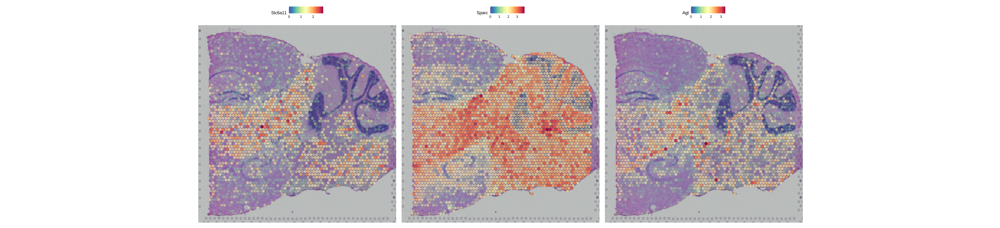

In [20]:
de_markers2 <- FindAllMarkers(brain2,only.pos = TRUE, min.pct = 0.1, logfc.threshold = 0.25)
SpatialFeaturePlot(object = brain2, features = rownames(de_markers2)[1:3], alpha = c(0.1, 1), ncol = 3)

In [74]:
brain_test <- FindSpatiallyVariableFeatures(brain1, assay = "SCT", features = VariableFeatures(brain1)[1:1000],
    selection.method = "markvariogram")

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


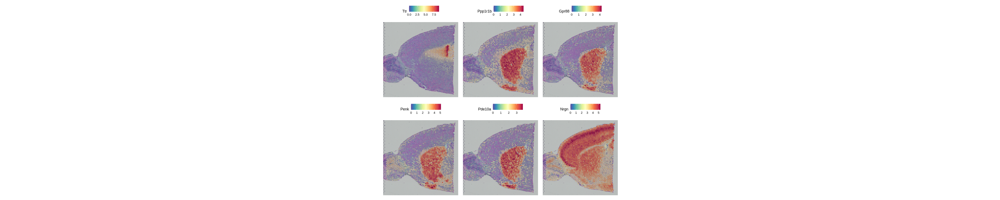

In [75]:
top.features <- head(SpatiallyVariableFeatures(brain_test, selection.method = "markvariogram"), 6)
SpatialFeaturePlot(brain_test, features = top.features, ncol = 3, alpha = c(0.1, 1))

In [16]:
write.csv(de_markers,"post1.csv")

In [16]:
write.csv(de_markers2,"post2.csv")

In [104]:
g1<-list(c("Mobp",	"Mbp",	"Plp1")); names(g1)<-"Oligodendrocyte"  

In [105]:
g2<-list(c("Pdgfra",	"Olig2",	"Sox10")); names(g2)<-"OPC"

In [106]:
g3<-list(c("Slc30a2",	"Vip",	"Npy",	"Sst",	"Pvalb",	"Lamp5",	"Scgn",	"Gad1",	"Gad2",	"Reln")); names(g3)<-"Inhibitory_neuron"

In [107]:
g4<-list(c("Nov",	"Baiap211",	"Spink8",	"Lefty1",	"Neurod6",	"Lpl",	"Bhlhe22",	"Tmem114")); names(g4)<-"Hippocampus"

In [108]:
g5<-list(c("Slc17a6",	"Slc17a7",	"Slc17a8")); names(g5)<-"Pan_EX"

In [109]:
g6<-list(c("Cux2")); names(g6)<-"L2/3"

In [110]:
g7<-list(c("Rorb")); names(g7)<-"L4"

In [111]:
g8<-list(c("Myl4","Fezf2")); names(g8)<-"L5"

In [112]:
g9<-list(c("Rprm")); names(g9)<-"L5/6"

In [113]:
g10<-list(c("Hpca")); names(g10)<-"CA"

In [114]:
g11<-list(c("Prox1")); names(g11)<-"DG"

In [115]:
g12<-list(c("Th")); names(g12)<-"DA_neuron"

In [116]:
g13<-list(c("Cplx3",	"Nxph3",	"Hs3st4",	"Ctgf")); names(g13)<-"L6b"

In [117]:
g14<-list(c("Slc1a2",	"Slc1a3",	"Slc4a4",	"Gfap",	"Aqp4")); names(g14)<-"Astrocyte"

In [126]:
g15<-list(c("C1qa",	"Scf1r",	"P2ry12",	"Cx3cr1")); names(g15)<-"Microglia"

In [127]:
g16<-list(c("Ptdgs")); names(g16)<-"Meninges"

In [128]:
g17<-list(c("Flt1","Cldn5")); names(g17)<-"Endothelial"

In [129]:
g18<-list(c("Pdgfrb")); names(g18)<-"Pericyte"

In [138]:
GENE=c(g1,g2,g3,g4,g5,g6,g7,g8,g9,g10,g11,g12,g13,g14,g15,g16,g17,g18)

In [139]:
GENE

$Oligodendrocyte
[1] "Mobp" "Mbp"  "Plp1"

$OPC
[1] "Pdgfra" "Olig2"  "Sox10" 

$Inhibitory_neuron
 [1] "Slc30a2" "Vip"     "Npy"     "Sst"     "Pvalb"   "Lamp5"   "Scgn"   
 [8] "Gad1"    "Gad2"    "Reln"   

$Hippocampus
[1] "Nov"      "Baiap211" "Spink8"   "Lefty1"   "Neurod6"  "Lpl"      "Bhlhe22" 
[8] "Tmem114" 

$Pan_EX
[1] "Slc17a6" "Slc17a7" "Slc17a8"

$`L2/3`
[1] "Cux2"

$L4
[1] "Rorb"

$L5
[1] "Myl4"  "Fezf2"

$`L5/6`
[1] "Rprm"

$CA
[1] "Hpca"

$DG
[1] "Prox1"

$DA_neuron
[1] "Th"

$L6b
[1] "Cplx3"  "Nxph3"  "Hs3st4" "Ctgf"  

$Astrocyte
[1] "Slc1a2" "Slc1a3" "Slc4a4" "Gfap"   "Aqp4"  

$Microglia
[1] "C1qa"   "Scf1r"  "P2ry12" "Cx3cr1"

$Meninges
[1] "Ptdgs"

$Endothelial
[1] "Flt1"  "Cldn5"

$Pericyte
[1] "Pdgfrb"

In [140]:
library(dplyr)

In [11]:
a<-de_markers %>% filter_all(any_vars(. %in% GENE))

In [12]:
write.csv(a,"de_markers_post1.csv")

In [142]:
saveRDS(GENE,"marker.rds")

In [17]:
Idents(brain1)<-"seurat_clusters"

In [ ]:
current.cluster.ids <- c(0,1,2,3,4,5,6,7,8,9,10,11,12,13)
new.cluster.ids <- c("CA","Oligodendrocyte","L6b","L5","L2/3","Astrocyte","DA_neuron","L4","Inhibitory_neuron","Pan_EX","L5/6","Inhibitory_neuron")
subset_epi$annotation<-plyr::mapvalues(x=subset_epi$annotation,from =current.cluster.ids, to = new.cluster.ids)

In [24]:
de_markers

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Ido1,1.104429e-265,1.242076,0.745,0.063,1.951306e-261,0,Ido1
Drd2,4.998010e-263,2.174569,0.955,0.207,8.830484e-259,0,Drd2
Lrrc10b,2.235104e-246,2.060989,0.960,0.240,3.948981e-242,0,Lrrc10b
Adora2a,1.744262e-245,2.213078,0.978,0.265,3.081762e-241,0,Adora2a
Syndig1l,3.698387e-237,2.136712,0.983,0.318,6.534310e-233,0,Syndig1l
Gpr6,1.097866e-232,1.638244,0.869,0.152,1.939709e-228,0,Gpr6
Rgs9,5.141487e-221,2.518250,0.998,0.486,9.083979e-217,0,Rgs9
Gpr88,6.947767e-216,2.918177,1.000,0.670,1.227532e-211,0,Gpr88
Drd1,1.518968e-215,1.817384,0.960,0.281,2.683713e-211,0,Drd1


In [25]:
de_markers2

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Trbc2,3.598971e-256,1.4412701,0.885,0.155,6.297480e-252,0,Trbc2
Myl4,4.229212e-230,1.6133274,0.929,0.240,7.400275e-226,0,Myl4
3110035E14Rik,6.915102e-203,1.8394873,1.000,0.624,1.210005e-198,0,3110035E14Rik
Fezf2,1.601227e-176,0.9587942,0.709,0.126,2.801826e-172,0,Fezf2
1110008P14Rik,6.817991e-168,1.1523721,1.000,0.976,1.193012e-163,0,1110008P14Rik
Dkk3,3.032974e-167,1.2827808,0.991,0.621,5.307098e-163,0,Dkk3
Ighm,2.179916e-164,1.3787599,0.748,0.188,3.814418e-160,0,Ighm
Snap25,6.031450e-163,0.9254069,1.000,1.000,1.055383e-158,0,Snap25
Adcy1,1.049138e-156,1.2494771,1.000,0.793,1.835781e-152,0,Adcy1


In [12]:
GENE<-c("Mobp",	"Mbp",	"Plp1",	"Pdgfra",	"Olig2",	"Sox10",	"Slc30a2",	"Vip",	"Npy",	"Sst",	"Pvalb",	"Lamp5",	"Scgn",	"Gad1",	"Gad2",	"Reln",	"Nov",	"Baiap211",	"Spink8",	"Lefty1",	"Neurod6",	"Lpl",	"Bhlhe22",	"Tmem114",	"Slc17a6",	"Slc17a7",	"Slc17a8",	"Cux2",	"Rorb",	"Myl4",	"Fezf2",	"Rprm",	"Hpca",	"prox1",	"Th",	"Cplx3",	"Nxph3",	"Hs3st4",	"Ctgf",	"Slc1a2",	"Slc1a3",	"Slc4a4",	"Gfap",	"Aqp4",	"C1qa",	"Scf1r",	"P2ry12",	"Cx3cr1",	"ptdgs",	"Flt1",	"Cldn5",	"Pdgfrb","Gad67","Nrn1")